In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
from sklearn.model_selection import train_test_split , GridSearchCV ,StratifiedKFold , cross_val_score
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import confusion_matrix , precision_recall_curve , roc_auc_score , roc_curve , classification_report
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier ,plot_tree
from sklearn.ensemble import VotingClassifier ,RandomForestClassifier ,AdaBoostClassifier ,GradientBoostingClassifier
from xgboost import XGBClassifier, plot_importance
import plotly.express as px
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)

In [2]:
df = pd.read_csv("../card_transdata.csv",encoding='utf-8')

In [3]:
df

,distance_from_home,distance_from_last_transaction,ratio_to_median_purchase_price,repeat_retailer,used_chip,used_pin_number,online_order,fraud
0,57.877857,0.311140,1.945940,1.0,1.0,0.0,0.0,0.0
1,10.829943,0.175592,1.294219,1.0,0.0,0.0,0.0,0.0
2,5.091079,0.805153,0.427715,1.0,0.0,0.0,1.0,0.0
3,2.247564,5.600044,0.362663,1.0,1.0,0.0,1.0,0.0
4,44.190936,0.566486,2.222767,1.0,1.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...
999995,2.207101,0.112651,1.626798,1.0,1.0,0.0,0.0,0.0
999996,19.872726,2.683904,2.778303,1.0,1.0,0.0,0.0,0.0
999997,2.914857,1.472687,0.218075,1.0,1.0,0.0,1.0,0.0
999998,4.258729,0.242023,0.475822,1.0,0.0,0.0,1.0,0.0


In [4]:
df.describe()

,distance_from_home,distance_from_last_transaction,ratio_to_median_purchase_price,repeat_retailer,used_chip,used_pin_number,online_order,fraud
count,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000
mean,26.628792,5.036519,1.824182,0.881536,0.350399,0.100608,0.650552,0.087403
std,65.390784,25.843093,2.799589,0.323157,0.477095,0.300809,0.476796,0.282425
min,0.004874,0.000118,0.004399,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.878008,0.296671,0.475673,1.000000,0.000000,0.000000,0.000000,0.000000
50%,9.967760,0.998650,0.997717,1.000000,0.000000,0.000000,1.000000,0.000000
75%,25.743985,3.355748,2.096370,1.000000,1.000000,0.000000,1.000000,0.000000
max,10632.723672,11851.104565,267.802942,1.000000,1.000000,1.000000,1.000000,1.000000


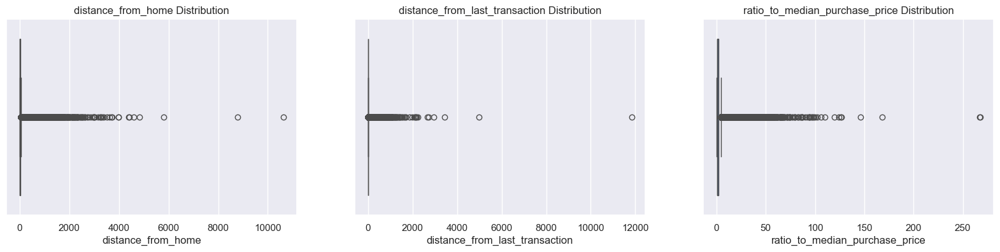

In [5]:
num_features = ['distance_from_home','distance_from_last_transaction','ratio_to_median_purchase_price']
fig,ax = plt.subplots(1,3,figsize=(20,4))
for i,col in enumerate(num_features):
    sns.boxplot(data=df,x=col,ax=ax[i])
    ax[i].set_title(f'{col} Distribution')

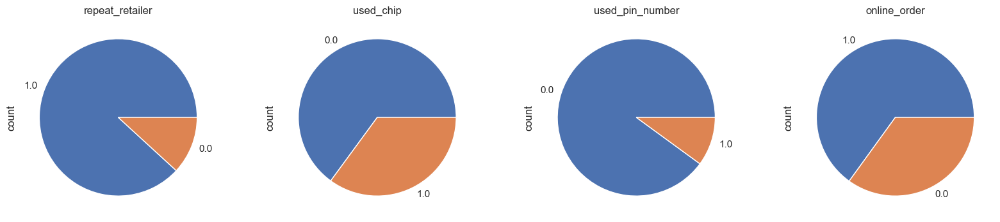

In [6]:
cat_features = ['repeat_retailer', 'used_chip','used_pin_number', 'online_order']
fig,ax = plt.subplots(1,4,figsize=(20,4))
for i,col in enumerate(cat_features):
    df[col].value_counts().plot(kind='pie',ax=ax[i],title=col)

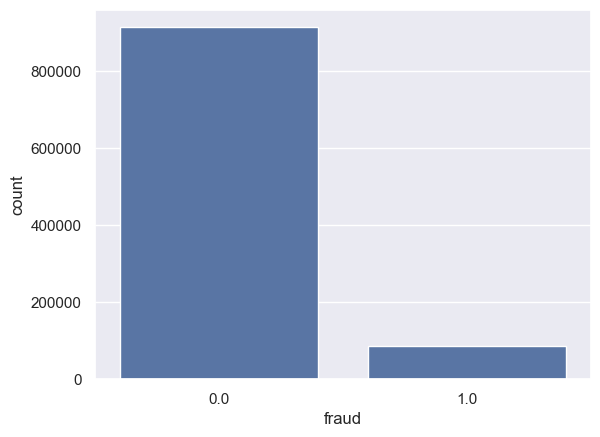

In [7]:
sns.countplot(data=df,x='fraud');

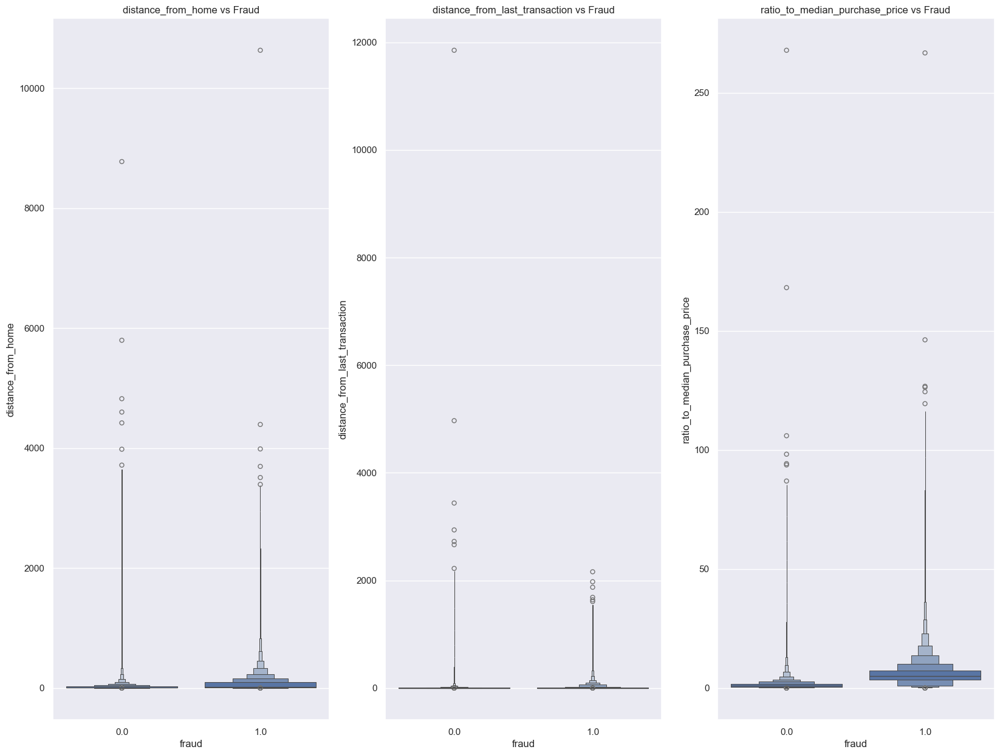

In [8]:
fig,ax = plt.subplots(1,3,figsize=(20,15))
for i,col in enumerate(num_features):
    sns.boxenplot(x=df['fraud'],y=df[col],ax=ax[i])
    ax[i].set_title(f'{col} vs Fraud')

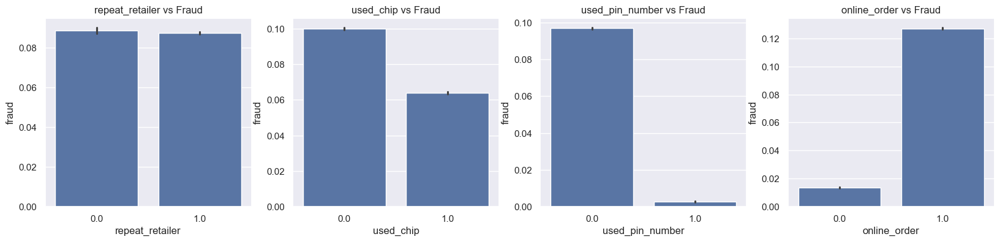

In [9]:
fig,ax = plt.subplots(1,4,figsize=(20,4))
for i,col in enumerate(cat_features):
    sns.barplot(data=df,x=col,y='fraud',ax=ax[i])
    ax[i].set_title(f'{col} vs Fraud')    

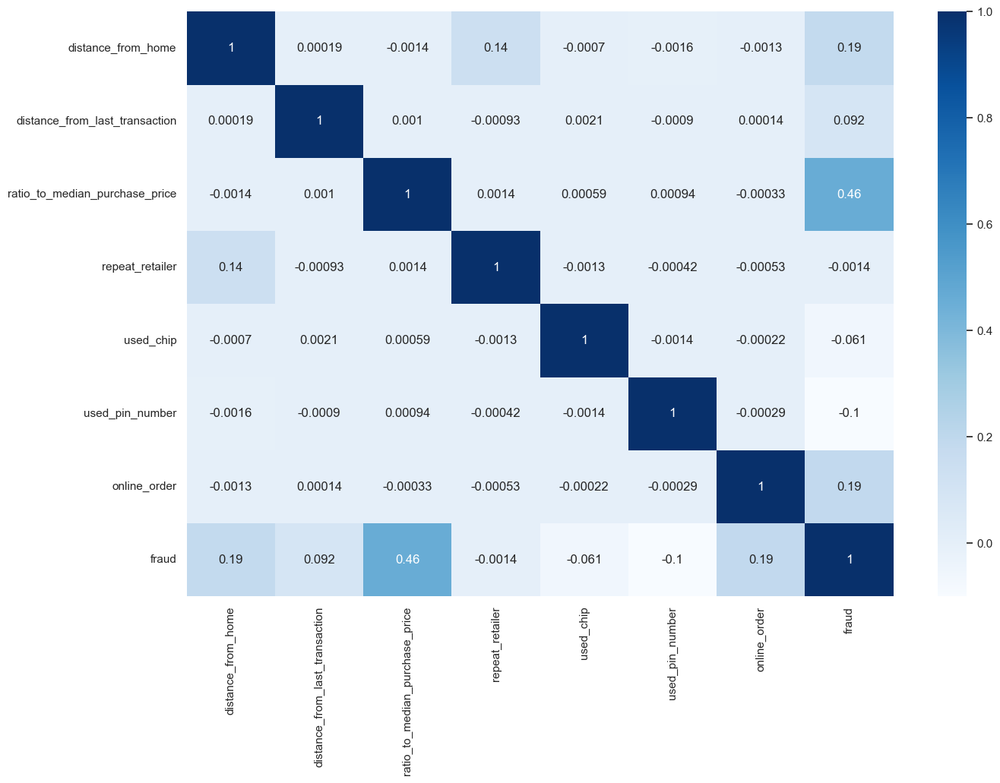

In [10]:
plt.figure(figsize=(15,10))
sns.heatmap(df.corr(),cmap='Blues',annot=True);

In [11]:
def validate(model,X_train,y_train,score,n):
    
    '''this function is to validate the model across multiple stratified splits'''
    
    splits = StratifiedKFold(n_splits=n)
    validate = cross_val_score(model,X_train,y_train,scoring=score,cv=splits)
    print('Cross Validation Scores: ',validate)
    print('Scores Mean: ',validate.mean())
    print('Scores Standard Deviation: ',validate.std())
    model.fit(X_train,y_train)
    return model

In [12]:
def model_tunning(model,X_train,y_train,param_grid):
    
    '''This function recieves a model then tune it using GridSearch 
    then print the best parameters and return the best estimator'''
    
    grid_search = GridSearchCV(estimator=model,param_grid=param_grid,cv=5,scoring='recall')
    grid_search.fit(X_train,y_train)
    best_params = grid_search.best_params_
    best_estimator = grid_search.best_estimator_
    best_score = grid_search.best_score_
    cv_results = pd.DataFrame(grid_search.cv_results_)
    print("Best parameters are: ",best_params)
    print('Mean cross-validated recall of the best_estimator is: ',best_score)
    #print(cv_results)
    return best_estimator

In [13]:
def model_evaluation(model,X_test,y_test,color='Blues',threshold=0.5):
    
    '''this function is to evaluate the model based on a given threshold
    1--> print the classification report     2--> display the confusion matrix'''
    
    #classification report
    y_proba_test = model.predict_proba(X_test)
    y_pred_test  = (y_proba_test[:,1]>=threshold)
    print(classification_report(y_test,y_pred_test,zero_division=0))
    #confusion matrix
    plt.figure(figsize=(5,4))
    sns.heatmap(confusion_matrix(y_test,y_pred_test),cmap=color,annot=True)
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.title('Confusion Matrix')

In [14]:
def precision_recall_trade_off(model,X_test,y_test):
    
    '''this function is to plot the precision-recall curve then
    printing the thresholds that achieves the highest recall'''
    
    y_proba = model.predict_proba(X_test)
    precision ,recall ,threshold = precision_recall_curve(y_test,y_proba[:,1])
    p_r_t = pd.DataFrame({'Threshold':threshold,'Precision':precision[:-1],'Recall':recall[:-1]})
    fig = px.line(
        p_r_t,
        x='Recall',
        y='Precision',
        title='Precision-Recall Curve',
        width=700,height=500,
        hover_data=['Threshold']
    )
    fig.show()
    print(p_r_t[ (p_r_t['Recall']==1)].tail(10))

In [15]:
def roc_auc(model,X_test,y_test):
    
    '''this function plots the roc-auc curve and calculate the model ROC-AUC score '''
    
    y_proba = model.predict_proba(X_test)
    fpr ,tpr ,threshold = roc_curve(y_test,y_proba[:,1])
    fp_tp = pd.DataFrame({'Threshold':threshold,'FPR':fpr,'TPR':tpr})
    fig = px.line(
        fp_tp,
        x='FPR',
        y='TPR',
        title='ROC Curve',
        width=700,height=500,
        hover_data=['Threshold']
    )
    fig.show()
    print('Testing ROC-AUC Score: ',roc_auc_score(y_test,y_proba[:,1]))

# Model Building

In [16]:
features = df.columns.drop(['fraud'])
target = 'fraud'

X = df[features]
y = df[target]

X_train , X_test ,y_train , y_test = train_test_split(X,y,test_size = 0.2 ,random_state = 42 ,stratify=y)

In [17]:
xgb = validate(XGBClassifier(n_estimators=500 ,random_state=42 ,n_jobs=-1),X_train,y_train,'recall',5)

Cross Validation Scores:  [0.99063215 0.98941648 0.9902746  0.98820164 0.98905971]
Scores Mean:  0.9895169155985206
Scores Standard Deviation:  0.0008679747406873597


In [18]:
precision_recall_trade_off(xgb,X_test,y_test)

        Threshold  Precision  Recall
179626   0.001308   0.967030     1.0
179627   0.001317   0.967083     1.0
179628   0.001319   0.967137     1.0
179629   0.001330   0.967190     1.0
179630   0.001333   0.967244     1.0
179631   0.001334   0.967297     1.0
179632   0.001337   0.967351     1.0
179633   0.001337   0.967405     1.0
179634   0.001338   0.967458     1.0
179635   0.001340   0.967512     1.0


              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00    730078
         1.0       0.97      1.00      0.99     69922

    accuracy                           1.00    800000
   macro avg       0.99      1.00      0.99    800000
weighted avg       1.00      1.00      1.00    800000



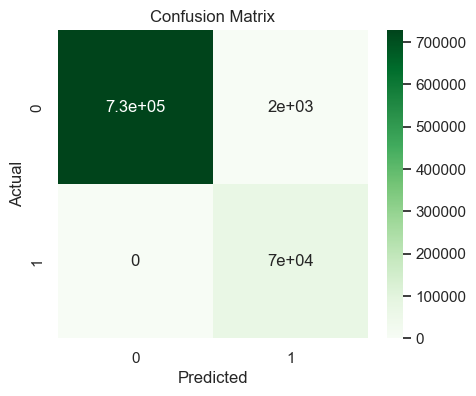

In [19]:
model_evaluation(xgb,X_train,y_train,'Greens',threshold=0.001976)

<Axes: title={'center': 'Feature importance'}, xlabel='F score', ylabel='Features'>

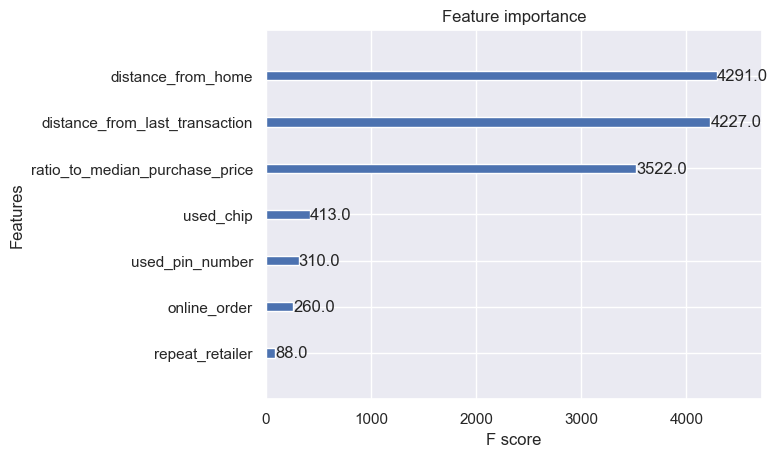

In [20]:
plot_importance(xgb)

In [21]:
roc_auc(xgb,X_test,y_test)

Testing ROC-AUC Score:  0.9999688627392398


In [22]:
import pickle
file_name = "xgb.pkl"

# save
pickle.dump(xgb, open(file_name, "wb"))

# load
xgb_model_loaded = pickle.load(open(file_name, "rb"))


In [23]:
X_test

,distance_from_home,distance_from_last_transaction,ratio_to_median_purchase_price,repeat_retailer,used_chip,used_pin_number,online_order
677554,5.674398,0.232067,1.192501,1.0,0.0,0.0,1.0
145563,198.012720,0.179870,1.139573,1.0,0.0,0.0,1.0
481407,31.001212,1.827891,0.249933,1.0,1.0,0.0,1.0
619391,26.419618,584.303355,0.548197,1.0,1.0,0.0,0.0
147719,1.023272,0.441577,2.363532,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...
71557,14.648848,11.291232,1.543347,1.0,1.0,1.0,1.0
317005,63.964091,0.170324,4.289147,1.0,1.0,0.0,0.0
231571,6.133256,2.405364,4.404161,1.0,1.0,0.0,0.0
79845,11.289984,1.050816,1.458511,1.0,1.0,0.0,0.0


In [24]:
x_values_dictionary = {'distance_from_home':0,
                      'distance_from_last_transaction':0,
                       'ratio_to_median_purchase_price':0,
                      'repeat_retailer':0,
                      'used_chip':0,
                       'used_pin_number':0,
                      'online_order':0 }

In [25]:
X_test.columns

Index(['distance_from_home', 'distance_from_last_transaction',
       'ratio_to_median_purchase_price', 'repeat_retailer', 'used_chip',
       'used_pin_number', 'online_order'],
      dtype='object')

In [26]:
xgb.get_xgb_params()

{'objective': 'binary:logistic',
 'base_score': None,
 'booster': None,
 'colsample_bylevel': None,
 'colsample_bynode': None,
 'colsample_bytree': None,
 'device': None,
 'eval_metric': None,
 'gamma': None,
 'grow_policy': None,
 'interaction_constraints': None,
 'learning_rate': None,
 'max_bin': None,
 'max_cat_threshold': None,
 'max_cat_to_onehot': None,
 'max_delta_step': None,
 'max_depth': None,
 'max_leaves': None,
 'min_child_weight': None,
 'monotone_constraints': None,
 'multi_strategy': None,
 'n_jobs': -1,
 'num_parallel_tree': None,
 'random_state': 42,
 'reg_alpha': None,
 'reg_lambda': None,
 'sampling_method': None,
 'scale_pos_weight': None,
 'subsample': None,
 'tree_method': None,
 'validate_parameters': None,
 'verbosity': None}

In [27]:
# param_grid = {
#     'n_estimators': [100, 200, 300, 400, 500],
#     'max_depth': [3, 4, 5, 6, 7, 8, 9, 10],
#     'learning_rate': [0.01, 0.05, 0.1, 0.2],
#     'subsample': [0.6, 0.7, 0.8, 0.9, 1.0],
#     'colsample_bytree': [0.6, 0.7, 0.8, 0.9, 1.0],
#     'gamma': [0, 0.1, 0.2, 0.3, 0.4, 0.5],
#     'min_child_weight': [1, 2, 3, 4, 5],
#     'scale_pos_weight': [1, 2, 3, 4, 5]
# }

# tuned_model = model_tunning(XGBClassifier(random_state=42 ,n_jobs=-1),X_train,y_train,param_grid)

In [28]:
df[df['fraud']==1].iloc[0]

distance_from_home                 2.131956
distance_from_last_transaction    56.372401
ratio_to_median_purchase_price     6.358667
repeat_retailer                    1.000000
used_chip                          0.000000
used_pin_number                    0.000000
online_order                       1.000000
fraud                              1.000000
Name: 13, dtype: float64

In [29]:
import time
from datetime import datetime
nowutc = time.strftime("%Y-%m-%d %H:%M:%SZ", time.gmtime())
print(nowutc)


2024-06-21 00:44:25Z


In [34]:
booster = xgb_model_loaded.get_booster()
feature_importance = booster.get_score(importance_type='gain')
feature_importance

{'distance_from_home': 26.0828800201416,
 'distance_from_last_transaction': 10.646113395690918,
 'ratio_to_median_purchase_price': 115.94739532470703,
 'repeat_retailer': 173.77972412109375,
 'used_chip': 122.8675765991211,
 'used_pin_number': 213.621826171875,
 'online_order': 659.9972534179688}